In [1]:
import momepy 
import osmnx as ox

In [35]:
streets_graph = ox.graph_from_place(
    "West , Amsterdam, Netherlands", network_type="bike"
)

/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/osmnx/geocoder.py:110: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(_geocode_query_to_gdf(q, wr, by_osmid))
/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/osmnx/utils_geo.py:280: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for polygon in geometry:
/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/osmnx/utils_geo.py:374: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in multipoly:
/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/osmnx/utils_geo.py:374: ShapelyDeprecationWarning: Iteration ov

In [36]:
streets_graph = ox.projection.project_graph(streets_graph)
edges = ox.graph_to_gdfs(
    streets_graph,
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True,
)

In [9]:
graph_path = '../results/output/caroline/240808_AMS_walknbike_shade_weight_240620.graphml'

graph_orig = ox.load_graphml(f'{graph_path}')

edges = ox.graph_to_gdfs(
    ox.convert.to_undirected(graph_orig),
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True,
)

Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3398, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/qg/ghhvk02j7t3f3b9th5d2412rxxy23f/T/ipykernel_33026/2247837300.py", line 3, in <cell line: 3>
    graph_orig = ox.load_graphml(f'{graph_path}')
  File "/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/osmnx/io.py", line 221, in load_graphml
    G = nx.read_graphml(filepath, node_type=default_node_dtypes["osmid"], force_multigraph=True)
  File "/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/networkx/utils/decorators.py", line 843, in func
    return argmap._lazy_compile(__wrapper)(*args, **kwargs)
  File "<class 'networkx.utils.decorators.argmap'> compilation 17", line 5, in argmap_read_graphml_13
  File "/opt/anaconda3/envs/geo_env/lib/python3.10/site-packages/networkx/readwrite/graphml.py", line 296, in read_graphml
    glist = list(reade

In [7]:
edges = ox.graph_to_gdfs(
    graph_orig,
    nodes=False,
    edges=True,
    node_geometry=False,
    fill_edge_geometry=True,
)

In [37]:
edges.explore()

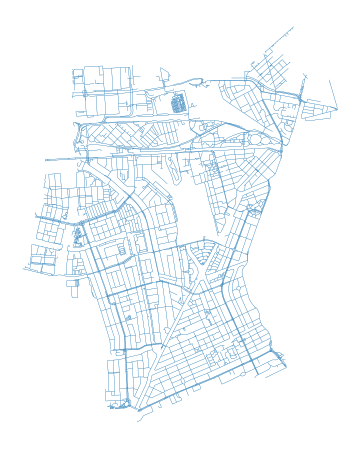

In [11]:
ax = edges.plot(linewidth=0.2, figsize=(8, 8))
ax.set_axis_off()

In [12]:
primal = momepy.gdf_to_nx(edges, approach="primal")

### Closeness centrality

the average distance to every other node from each node. As such, it can be measured on the whole network (Global Closeness Centrality) or within a certain limit only (Local Closeness Centrality).

#### Local closeness
To measure local closeness_centrality we need to specify a radius (how far we should go from each node). We can use topological distance (e.g. 5 steps, then radius=5) or metric distance (e.g. 400 metres) - then radius=400 and distance=length of each segment saved as a parameter of each edge. By default, momepy saves length as mm_len.

The weight parameter is used for centrality calculation. Again, we can use metric weight (using the same attribute as above) or no weight (weight=None) at all. Or any other attribute we wish.

In [13]:
primal = momepy.closeness_centrality(
    primal, radius=400, name="closeness400", distance="mm_len", weight="mm_len"
)

  0%|          | 0/3776 [00:00<?, ?it/s]

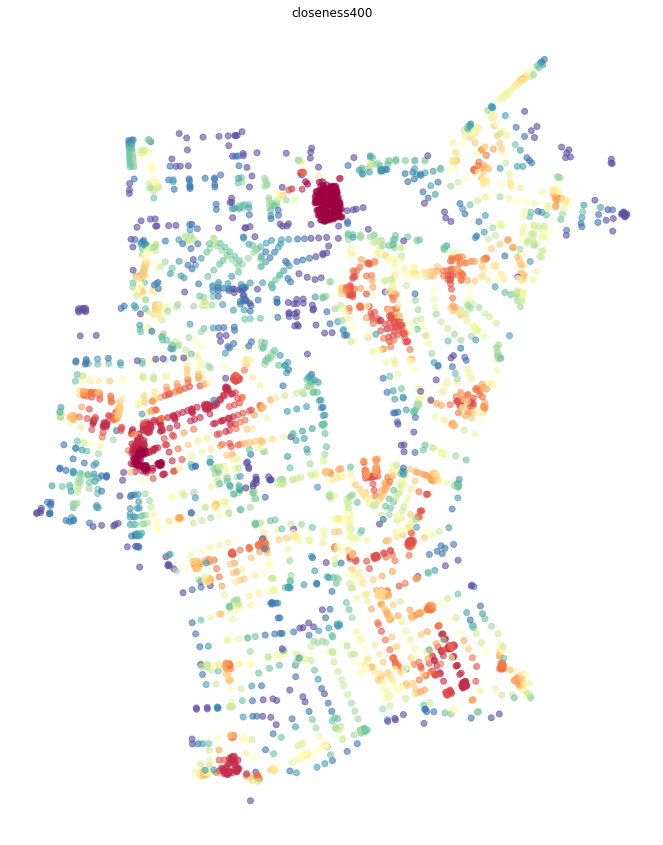

In [14]:
nodes = momepy.nx_to_gdf(primal, lines=False)
ax = nodes.plot(
    column="closeness400",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("closeness400")

#### Global closeness
Global closeness centrality is a bit simpler as we do not have to specify radius and distance, the rest remains the same.

In [15]:
primal = momepy.closeness_centrality(
    primal, name="closeness_global", weight="mm_len"
)

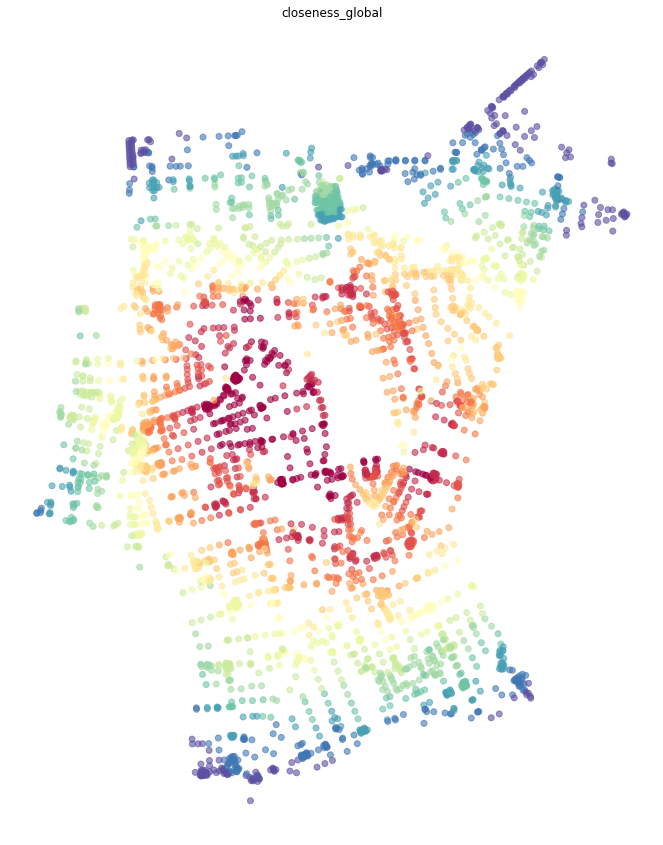

In [17]:
nodes = momepy.nx_to_gdf(primal, lines=False)
ax = nodes.plot(
    column="closeness_global",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("closeness_global")

### Betweenness
Betweenness centrality measures the importance of each node or edge for travelling along the network. It measures how many times each node/edge used if we walk using the shortest paths from each node to every other.

We have two options of how to measure betweenness on primal graphs - on nodes or on edges.

##### Node-based
Node-based betweenness, as the name suggests, measures the betweenness of each node - how many times we would walk through the node.

In [18]:
primal = momepy.betweenness_centrality(
    primal, name="betweenness_metric_n", mode="nodes", weight="mm_len"
)

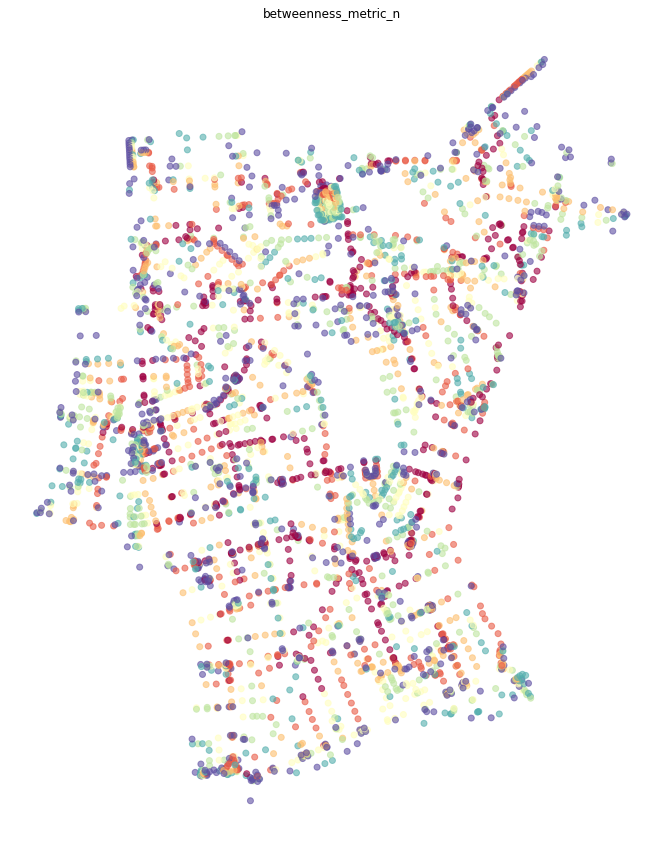

In [19]:
nodes = momepy.nx_to_gdf(primal, lines=False)
ax = nodes.plot(
    column="betweenness_metric_n",
    cmap="Spectral_r",
    scheme="quantiles",
    k=7,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("betweenness_metric_n")

##### Edge-based
Edge-based betweenness does the same but for edges: how many times we go through each edge (street).

In [20]:
primal = momepy.betweenness_centrality(
    primal, name="betweenness_metric_e", mode="edges", weight="mm_len"
)

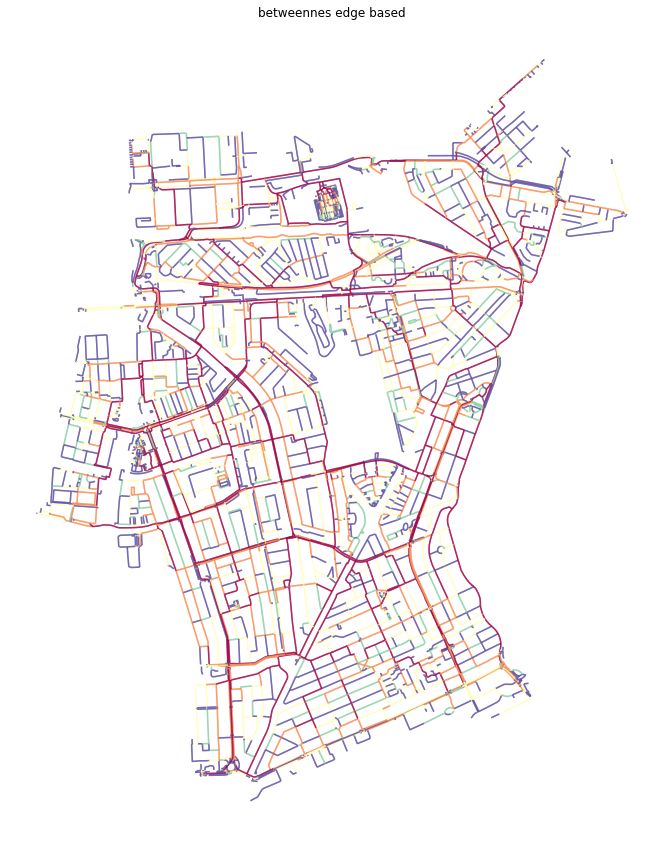

In [21]:
primal_gdf = momepy.nx_to_gdf(primal, points=False)
ax = primal_gdf.plot(
    column="betweenness_metric_e",
    cmap="Spectral_r",
    scheme="quantiles",
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("betweennes edge based")

In [31]:
primal_gdf.columns

Index(['osmid', 'oneway', 'name', 'highway', 'maxspeed', 'length', 'geometry',
       'lanes', 'width', 'ref', 'bridge', 'tunnel', 'service', 'access',
       'junction', 'mm_len', 'betweenness_metric_e', 'straightness',
       'closeness400', 'closeness_global', 'betweenness_metric_n'],
      dtype='object')

In [33]:
primal_gdf.explore(column='betweenness_metric_e', scheme="quantiles")

#### Straightness
While both closeness and betweenness are generally used in many applications of network analysis, straightness centrality is specific to street networks as it requires a geographical element. It is measured as a ratio between real and Euclidean distance while waking from each node to every other.

In [22]:
primal = momepy.straightness_centrality(primal)

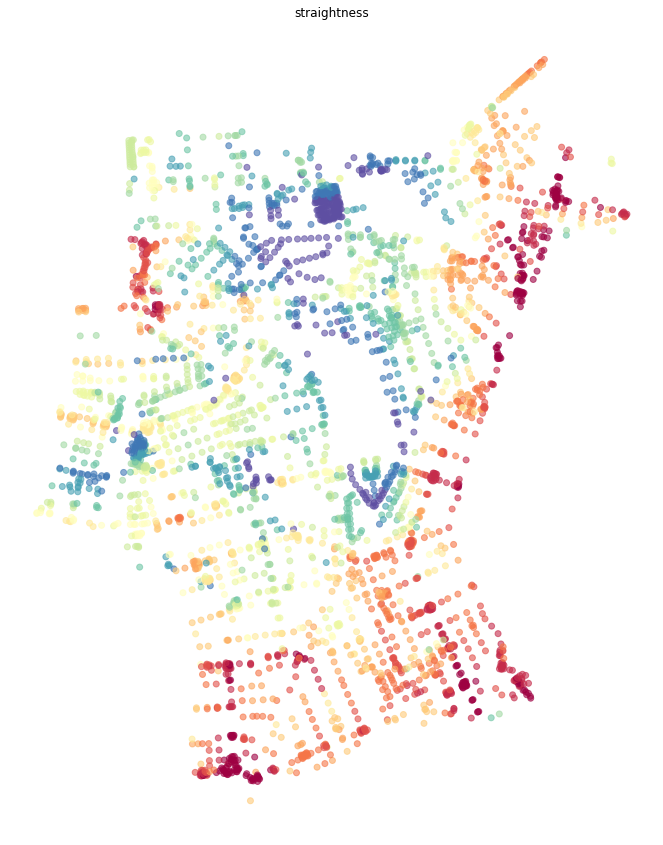

In [23]:
nodes = momepy.nx_to_gdf(primal, lines=False)
ax = nodes.plot(
    column="straightness",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("straightness")

#### Node values averaged onto edges
In some cases, it is easier to understand centrality results if they are attached to street segments, rather than intersections. We can do an approximation using the mean value attached to start and end node of each edge.

In [24]:
momepy.mean_nodes(primal, "straightness")
momepy.mean_nodes(primal, "closeness400")
momepy.mean_nodes(primal, "closeness_global")
momepy.mean_nodes(primal, "betweenness_metric_n")

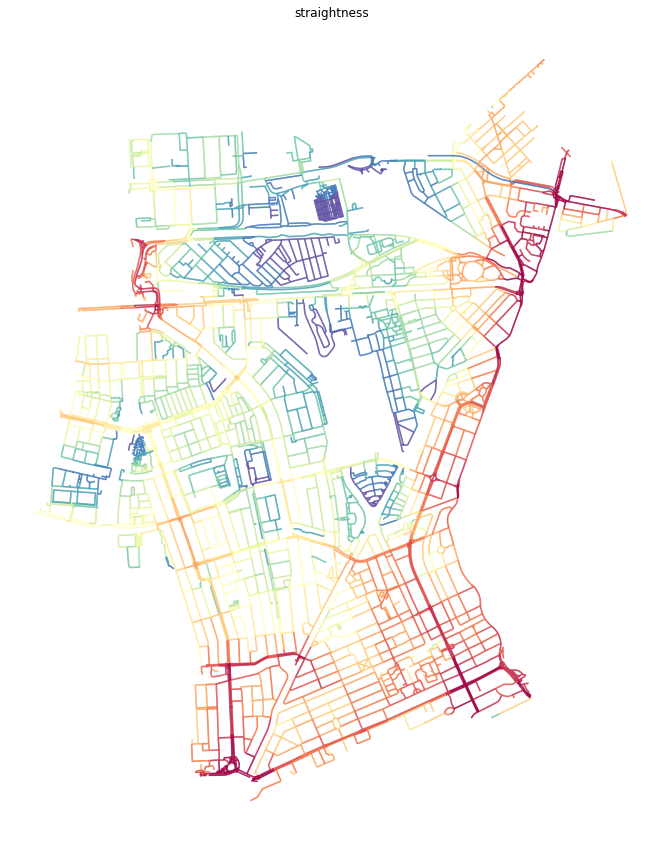

In [25]:
primal_gdf = momepy.nx_to_gdf(primal, points=False)

ax = primal_gdf.plot(
    column="straightness",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("straightness")

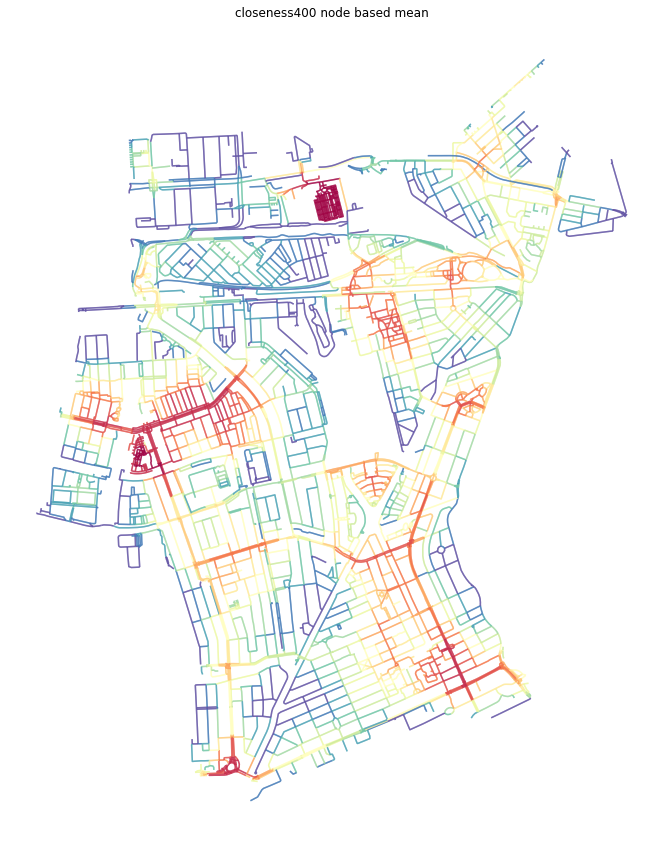

In [26]:
ax = primal_gdf.plot(
    column="closeness400",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("closeness400 node based mean")

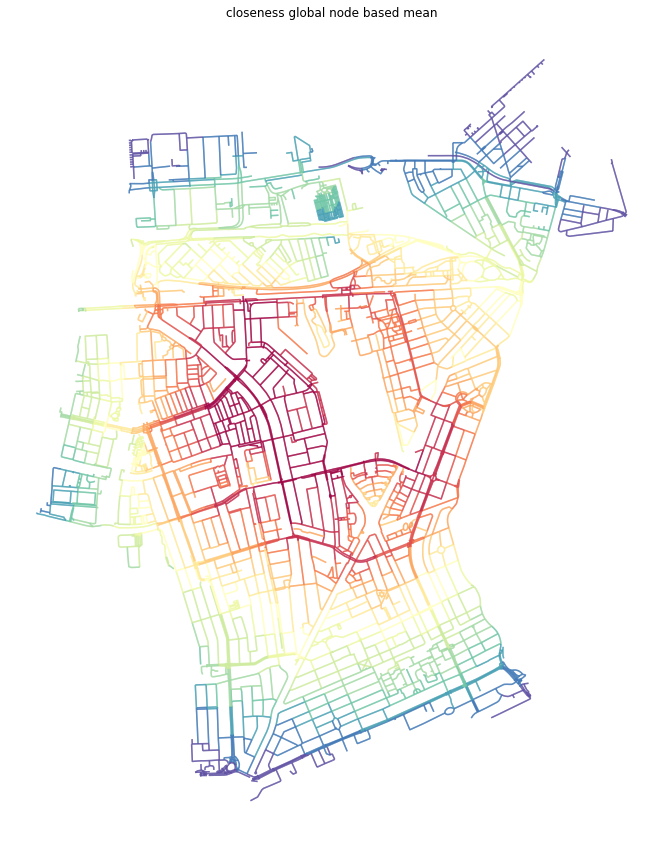

In [27]:
ax = primal_gdf.plot(
    column="closeness_global",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("closeness global node based mean")

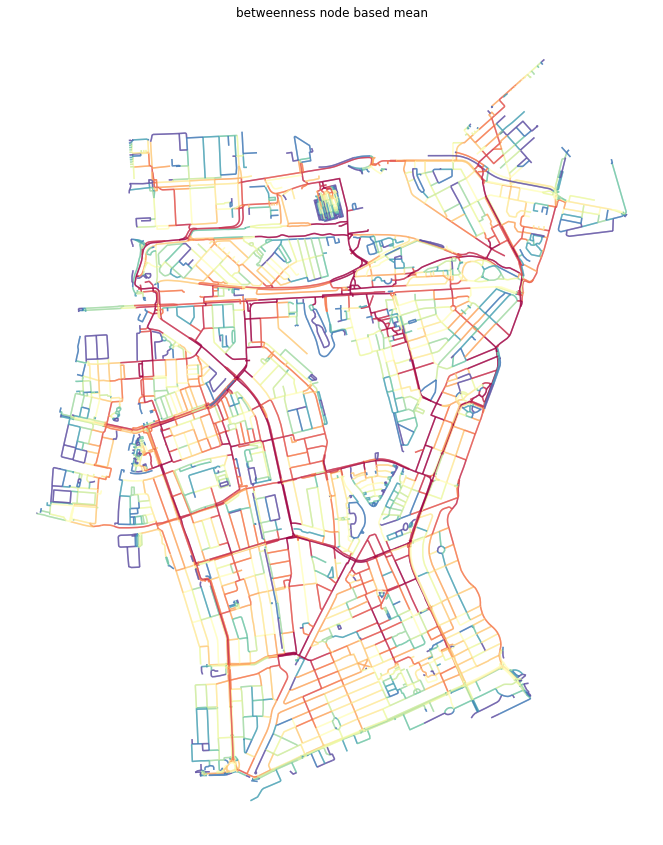

In [29]:
ax = primal_gdf.plot(
    column="betweenness_metric_n",
    cmap="Spectral_r",
    scheme="quantiles",
    k=15,
    alpha=0.6,
    figsize=(15, 15),
)
ax.set_axis_off()
_ = ax.set_title("betweenness node based mean")

In [ ]:
nodes, edges_p = momepy.nx_to_gdf(primal)